# Cargando Datos

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [3]:
df = pd.read_csv('sample.txt', sep=',')

In [4]:
df

,key,fare_amount,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count
0,2015-06-01 21:41:06.0000002,8.0,2015-06-01 21:41:06 UTC,-73.961784,40.759579,-73.978943,40.772606,4
1,2011-04-30 04:15:00.00000035,7.7,2011-04-30 04:15:00 UTC,-73.982377,40.739743,-73.959688,40.758598,5
2,2014-10-07 22:42:17.0000001,10.0,2014-10-07 22:42:17 UTC,-73.988080,40.748038,-73.969405,40.760167,1
3,2010-06-27 23:44:00.000000147,7.7,2010-06-27 23:44:00 UTC,-73.981420,40.728892,-73.976100,40.752308,3
4,2011-02-26 18:39:00.00000010,9.3,2011-02-26 18:39:00 UTC,-73.989087,40.736433,-73.980730,40.763753,1
...,...,...,...,...,...,...,...,...
55625,2012-02-15 23:35:28.0000002,8.1,2012-02-15 23:35:28 UTC,-73.987463,40.719881,-74.002188,40.739658,1
55626,2013-08-22 13:50:00.000000170,6.0,2013-08-22 13:50:00 UTC,-73.991790,40.759632,-73.987547,40.754550,1
55627,2012-06-13 18:48:00.000000255,7.3,2012-06-13 18:48:00 UTC,-73.973317,40.752730,-73.961597,40.772783,1
55628,2010-10-26 18:16:00.000000226,3.7,2010-10-26 18:16:00 UTC,-73.957540,40.776578,-73.957540,40.776578,1


# 1. Análisis Exploratorio de Datos

Podemos observar que tenemos variables numéricas mayoritariamente.

In [5]:
df.dtypes

key                   object
fare_amount          float64
pickup_datetime       object
pickup_longitude     float64
pickup_latitude      float64
dropoff_longitude    float64
dropoff_latitude     float64
passenger_count        int64
dtype: object

In [6]:
df.describe()

,fare_amount,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count
count,55630.000000,55630.000000,55630.000000,55630.000000,55630.000000,55630.000000
mean,11.272595,-72.556495,39.995352,-72.527792,39.972317,1.689161
std,9.560758,11.641094,15.034790,10.533922,8.140312,1.309506
min,-52.000000,-1344.880998,-74.007272,-75.463551,-74.012647,0.000000
25%,6.000000,-73.991991,40.734924,-73.991470,40.734048,1.000000
50%,8.500000,-73.981790,40.752651,-73.980331,40.753006,1.000000
75%,12.500000,-73.967142,40.766976,-73.964004,40.767893,2.000000
max,250.000000,40.789280,3292.713403,448.898563,1293.422547,6.000000


In [7]:
#sns.scatterplot(data=df, x='pickup_latitude', y='pickup_longitude', color='green', alpha=0.1)
#sns.scatterplot(data=df, x='dropoff_latitude', y='dropoff_longitude', color='red', alpha=0.1)
#plt.show()

In [8]:
#sns.histplot(df.fare_amount, kde=True)
#plt.show()

In [9]:
#sns.histplot(df.passenger_count, kde=True)
#plt.show()

In [10]:
variables_numericas = ['fare_amount', 'pickup_longitude', 'pickup_latitude', 'dropoff_longitude', 'dropoff_latitude', 'passenger_count']

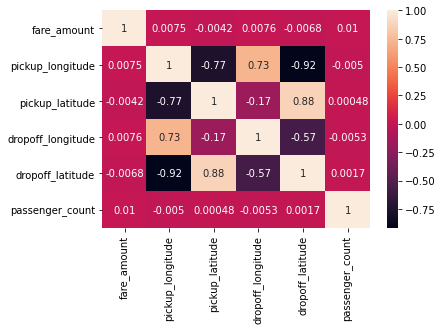

In [11]:
sns.heatmap(df[variables_numericas].corr(), annot=True)
plt.show()

# 2. Data Cleaning

In [12]:
#df = df[(-100.0 <= df['pickup_longitude']) & (df['pickup_longitude'] <= 180.0) &
#                (-90.0 <= df['pickup_latitude']) & (df['pickup_latitude'] <= 90) &
#                (-180.0 <= df['dropoff_longitude']) & (df['dropoff_longitude'] <= 180.0) &
#                (-90.0 <= df['dropoff_latitude']) & (df['dropoff_latitude'] <= 90) &
#                (2.0 < df['fare_amount']) & (df['fare_amount'] < 200)]

# 3. Feature Engineering

## Distancia de Manhattan

In [13]:
df['distancia_manhattan'] = ((df['dropoff_longitude']-df['pickup_longitude'])**2 + (df['dropoff_latitude']-df['pickup_latitude'])**2)**(1/2)

ipykernel_launcher:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


In [14]:
variables = ['fare_amount', 'pickup_longitude', 'pickup_latitude', 'dropoff_longitude', 'dropoff_latitude', 'passenger_count','distancia_manhattan']

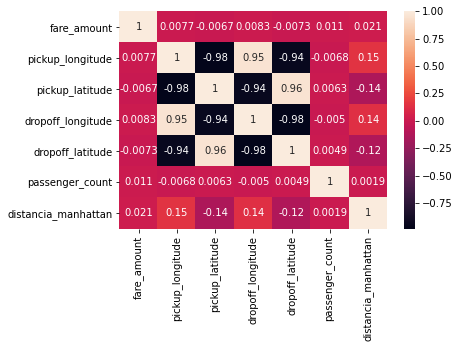

In [15]:
#sns.heatmap(df[variables].corr(), annot=True)
#plt.show()

## Distancia de Haversine

In [16]:
from math import sin,cos,sqrt,asin,pi

latitud = df['dropoff_latitude']-df['pickup_latitude']
longitud = df['dropoff_longitude']-df['pickup_longitude']

conversion = pi/180

latitud_rad = conversion*latitud
longitud_rad = conversion*longitud

seno1 = ((latitud_rad/2).apply(sin))**2
seno2 = ((longitud_rad/2).apply(sin))**2

coseno1 = (conversion*df['pickup_latitude']).apply(cos)
coseno2 = (conversion*df['dropoff_latitude']).apply(cos)

radio = 6371000

distancia_haversine = 2*radio*((seno1 + coseno1*coseno2*seno2).apply(sqrt)).apply(asin)

df['distancia_haversine'] = distancia_haversine

ipykernel_launcher:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


## Variables

In [17]:
df['pickup_datetime'] = pd.to_datetime(df.pickup_datetime)
df['year'] = df.pickup_datetime.dt.year
df['month'] = df.pickup_datetime.dt.month
df['day'] = df.pickup_datetime.dt.day
df['time'] = df.pickup_datetime.dt.time
df['hour'] = df.pickup_datetime.dt.hour

ipykernel_launcher:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
ipykernel_launcher:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
ipykernel_launcher:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
ipykernel_launcher:4: SettingWithCopyWarning: 
A value is trying to be

In [18]:
variables = ['fare_amount','pickup_longitude','pickup_latitude','dropoff_longitude','dropoff_latitude', 'passenger_count','year','month','day','hour','distancia_haversine','distancia_manhattan']

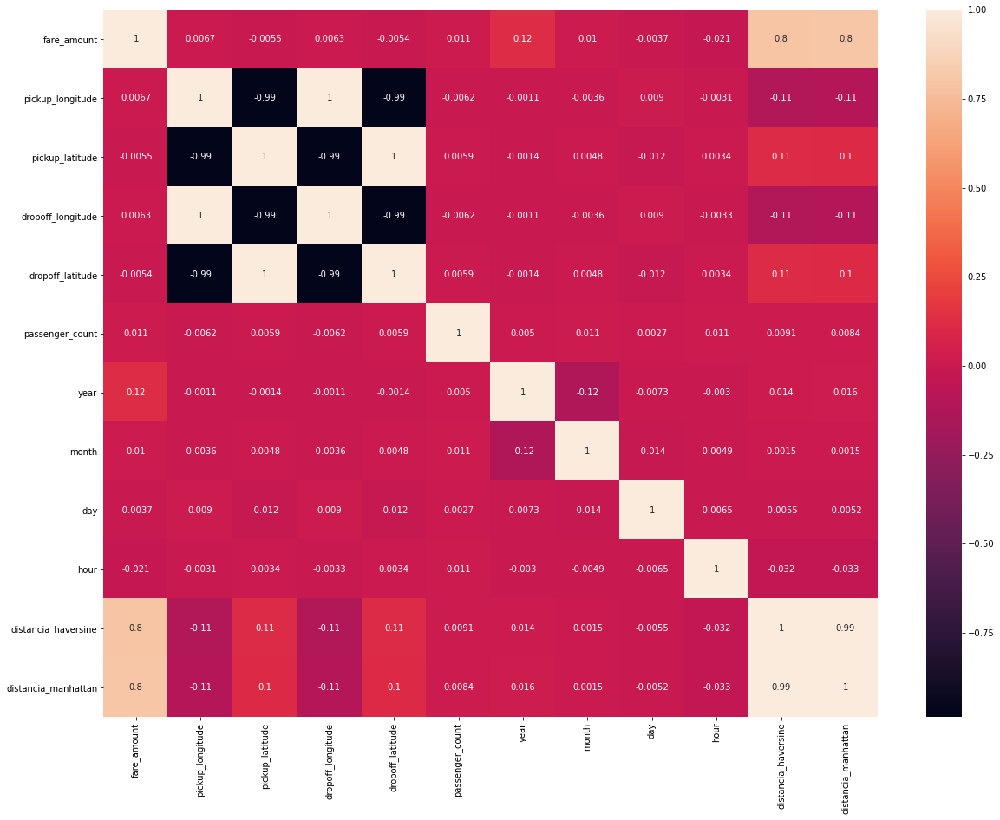

In [19]:
#plt.figure(figsize=(20,15))
#sns.heatmap(df[df['distancia_haversine']<100000][variables].corr(), annot=True)
#plt.show()

In [20]:
#sns.pairplot(df[['fare_amount','distancia_haversine','distancia_manhattan']])
#plt.show()

df[df['distancia_haversine']<100000][variables].corr()

,fare_amount,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,year,month,day,hour,distancia_haversine,distancia_manhattan
fare_amount,1.000000,0.006654,-0.005532,0.006286,-0.005375,0.010762,0.116868,0.010210,-0.003744,-0.021320,0.796460,0.804415
pickup_longitude,0.006654,1.000000,-0.985359,0.999992,-0.985360,-0.006158,-0.001078,-0.003645,0.009019,-0.003123,-0.114080,-0.108224
pickup_latitude,-0.005532,-0.985359,1.000000,-0.985358,0.999985,0.005908,-0.001431,0.004807,-0.011609,0.003437,0.109928,0.103739
dropoff_longitude,0.006286,0.999992,-0.985358,1.000000,-0.985358,-0.006175,-0.001098,-0.003633,0.009016,-0.003321,-0.114465,-0.108630
dropoff_latitude,-0.005375,-0.985360,0.999985,-0.985358,1.000000,0.005921,-0.001443,0.004772,-0.011606,0.003407,0.110142,0.103939
passenger_count,0.010762,-0.006158,0.005908,-0.006175,0.005921,1.000000,0.005037,0.010654,0.002721,0.010914,0.009083,0.008409
year,0.116868,-0.001078,-0.001431,-0.001098,-0.001443,0.005037,1.000000,-0.118993,-0.007338,-0.002970,0.014428,0.016159
month,0.010210,-0.003645,0.004807,-0.003633,0.004772,0.010654,-0.118993,1.000000,-0.013536,-0.004916,0.001459,0.001476
day,-0.003744,0.009019,-0.011609,0.009016,-0.011606,0.002721,-0.007338,-0.013536,1.000000,-0.006490,-0.005519,-0.005202
hour,-0.021320,-0.003123,0.003437,-0.003321,0.003407,0.010914,-0.002970,-0.004916,-0.006490,1.000000,-0.032202,-0.032813


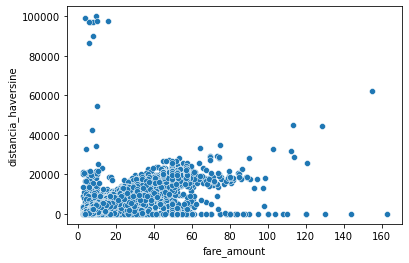

In [26]:
sns.scatterplot(data=df[df['distancia_haversine']<100000], x='fare_amount', y='distancia_haversine')
plt.show()

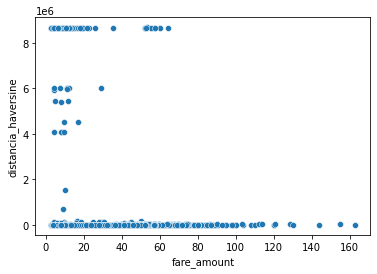

In [22]:
sns.scatterplot(data=df, x='fare_amount', y='distancia_haversine')
plt.show()

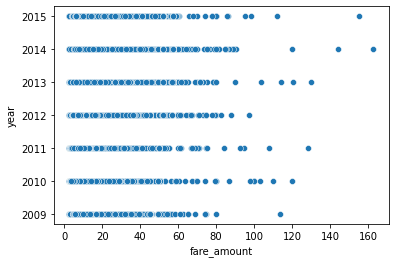

In [27]:
sns.scatterplot(data=df, x='fare_amount', y='year')
plt.show()